# Data science project : prediction of data science salaries 

In [2]:
import pandas as pd
import numpy as np 
import seaborn as sns;
from matplotlib import pyplot as plt
from datetime import date;
from sklearn.model_selection import train_test_split
pd.set_option("display.max_columns", None)
#pd.set_option('display.max_rows', None)

In [3]:
df = pd.read_csv('ds/listings.csv')

# Part 1 : Data Cleaning 

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1498 entries, 0 to 1497
Data columns (total 52 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   jobId                  1498 non-null   int64  
 1   jobTitle               1498 non-null   object 
 2   jobClassification      1498 non-null   object 
 3   jobSubClassification   1498 non-null   object 
 4   advertiserName         1498 non-null   object 
 5   advertiserId           1498 non-null   int64  
 6   companyId              162 non-null    float64
 7   companyName            419 non-null    object 
 8   companyRating          162 non-null    float64
 9   listingDate            1498 non-null   object 
 10  expiryDate             1498 non-null   object 
 11  teaser                 1498 non-null   object 
 12  nation                 1498 non-null   object 
 13  state                  1498 non-null   object 
 14  city                   1498 non-null   object 
 15  area

Nous pouvons constater que notre dataset est constitué majoritairement de valeurs numériques avec 52 propriétés. Cela nous permettra de construire des analyses quantitatives et notament nos engeneering features...

In [5]:
nb_data = len(df.index); nb_data

1498

In [6]:
df.head(50)

,jobId,jobTitle,jobClassification,jobSubClassification,advertiserName,advertiserId,companyId,companyName,companyRating,listingDate,expiryDate,teaser,nation,state,city,area,suburb,workType,salary_string,isRightToWorkRequired,desktopAdTemplate,mobileAdTemplate,companyProfileUrl,seekJobListingUrl,R,Python,Matlab,SQL,Stata,Minitab,SPSS,Ruby,C,Scala,Tableau,Java,Hadoop,SAS,Julia,Knime,D3,Clojure,Haskell,Lisp,Golang,Spark,Javascript,F#,Fortran,first_seen,last_seen,recruiter
0,38098375,Senior Method Development Immunoassay Scientis...,Science & Technology,Biological & Biomedical Sciences,Hobson Prior Australia,30969882,NaN,NaN,NaN,2019-01-16 12:17:41,2019-03-15 16:17:42,My client is a leading Australian-owned and ra...,Australia,New South Wales,Sydney,"CBD, Inner West & Eastern Suburbs",sydney,Full Time,NaN,f,\n \n \n Senior Method Development Im...,My client is a leading Australian owned and ra...,NaN,https://www.seek.com.au/job/38098375?type=stan...,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2019-03-06,2019-03-11,1
1,38259053,Pricing Data Scientist - Lower North Shore,Information & Communication Technology,Other,Randstad - Technologies,26537413,NaN,NaN,NaN,2019-02-04 13:02:22,2019-03-06 23:59:59,The Data Scientist will be responsible for mon...,Australia,Australian Capital Territory,ACT,NaN,NaN,Full Time,Super,t,\n \n \n \n Pricing Data Scientist...,Leading financial services organisation is hir...,NaN,https://www.seek.com.au/job/38259053?type=stan...,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,2019-03-06,2019-03-06,1
2,38267899,Insights Analyst – Online Video Streaming,Information & Communication Technology,Database Development & Administration,Aurec,39407892,NaN,NaN,NaN,2019-02-05 11:33:08,2019-03-07 23:59:59,Fantastic organisation seeks experienced Insig...,Australia,New South Wales,Sydney,NaN,NaN,Full Time,$90000 - $120000 per annum,f,\n \n \n \n Insights Analyst – Onl...,The Company:A big brand with a reputation for ...,NaN,https://www.seek.com.au/job/38267899?type=stan...,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2019-03-06,2019-03-07,1
3,38267995,Credit Risk Analyst,Banking & Financial Services,Compliance & Risk,Huxley Associates,26057722,NaN,NaN,NaN,2019-02-05 11:39:26,2019-03-07 23:59:59,This role requires an individual with strong c...,Australia,New South Wales,Sydney,NaN,NaN,Full Time,$90k - $110k p.a.,f,\n \n \n \n Credit Risk Analyst \n...,Responsibilities: Design and development of s...,NaN,https://www.seek.com.au/job/38267995?type=stan...,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,2019-03-06,2019-03-07,1
4,38269206,Data Scientist,Information & Communication Technology,Database Development & Administration,FinXL IT Professional Services,33086778,NaN,NaN,NaN,2019-02-05 12:54:11,2019-03-07 23:59:59,"Our client, a large Sydney based telecommunica...",Australia,New South Wales,Sydney,North Shore & Northern Beaches,NaN,Contract/Temp,NaN,f,\n \n \n \n Data Scientist \n ...,"• Large, high profile organisation• Unique Pro...",NaN,https://www.seek.com.au/job/38269206?type=stan...,0,1,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,2019-03-06,2019-03-07,0
5,38269216,Data Scientist,Information & Communication Technology,Database Development & Administration,FinXL IT Professional Services,33086778,NaN,NaN,NaN,2019-02-05 12:55:07,2019-03-07 23:59:59,"Our client, a large Sydney based telecommunica...",Australia,New South Wales,Sydney,North Shore & Northern Beaches,NaN,Contract/Temp,NaN,f,\n \n \n \n Data Scientist \n ...,"• Large, high profile organisation• Unique Pro...",NaN,https://www.seek.com.au/job/38269216?type=stan...,1,1,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,2019-03-06,2019-03-07,0
6,38270740,Data Scientist,Banking & Financial Services,Analysis & Reporting,Macquarie Group Limited,23039563,NaN,Macquarie Group,NaN,2019-02-05 14:24:57,2019-03-07 23:59:59,A fantastic opportunity for you to showcase yo...,Australia,New South Wales,Sydney,"CBD, Inner West & Eastern Suburbs",sydney,Full Time,NaN,t

In [7]:
df['salary_string'].head(50)

0                                                   NaN
1                                                 Super
2                            $90000 - $120000 per annum
3                                     $90k - $110k p.a.
4                                                   NaN
5                                                   NaN
6                                                   NaN
7         $110k - $120k p.a. + super + bonus + benefits
8                             Attractive Salary Package
9                                                   NaN
10            $71,509 - $90,215 per plus superannuation
11            $71,509 - $90,215 per plus superannuation
12      $134421 - $148725 p.a. + plus up to 15.4% super
13      $134421 - $148725 p.a. + plus up to 15.4% super
14                                                  NaN
15                                                  NaN
16                                                  NaN
17                                  $120,000 - $

In [8]:
nb_nan = df['salary_string'].isna().sum();

In [9]:
ratio = round(((nb_nan / nb_data)*100), 2); ratio

62.15

In [10]:
df = pd.read_csv('ds/dataScientist.csv');
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3909 entries, 0 to 3908
Data columns (total 17 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Unnamed: 0         3909 non-null   int64  
 1   index              3909 non-null   int64  
 2   Job Title          3909 non-null   object 
 3   Salary Estimate    3909 non-null   object 
 4   Job Description    3909 non-null   object 
 5   Rating             3909 non-null   float64
 6   Company Name       3909 non-null   object 
 7   Location           3909 non-null   object 
 8   Headquarters       3909 non-null   object 
 9   Size               3909 non-null   object 
 10  Founded            3909 non-null   int64  
 11  Type of ownership  3909 non-null   object 
 12  Industry           3909 non-null   object 
 13  Sector             3909 non-null   object 
 14  Revenue            3909 non-null   object 
 15  Competitors        3909 non-null   object 
 16  Easy Apply         3909 

In [11]:
df.head()

,Unnamed: 0,index,Job Title,Salary Estimate,Job Description,Rating,Company Name,Location,Headquarters,Size,Founded,Type of ownership,Industry,Sector,Revenue,Competitors,Easy Apply
0,0,0,Senior Data Scientist,$111K-$181K (Glassdoor est.),"ABOUT HOPPER\n\nAt Hopper, we’re on a mission ...",3.5,Hopper\n3.5,"New York, NY","Montreal, Canada",501 to 1000 employees,2007,Company - Private,Travel Agencies,Travel & Tourism,Unknown / Non-Applicable,-1,-1
1,1,1,"Data Scientist, Product Analytics",$111K-$181K (Glassdoor est.),"At Noom, we use scientifically proven methods ...",4.5,Noom US\n4.5,"New York, NY","New York, NY",1001 to 5000 employees,2008,Company - Private,"Health, Beauty, & Fitness",Consumer Services,Unknown / Non-Applicable,-1,-1
2,2,2,Data Science Manager,$111K-$181K (Glassdoor est.),Decode_M\n\nhttps://www.decode-m.com/\n\nData ...,-1.0,Decode_M,"New York, NY","New York, NY",1 to 50 employees,-1,Unknown,-1,-1,Unknown / Non-Applicable,-1,True
3,3,3,Data Analyst,$111K-$181K (Glassdoor est.),Sapphire Digital seeks a dynamic and driven mi...,3.4,Sapphire Digital\n3.4,"Lyndhurst, NJ","Lyndhurst, NJ",201 to 500 employees,2019,Company - Private,Internet,Information Technology,Unknown / Non-Applicable,"Zocdoc, Healthgrades",-1
4,4,4,"Director, Data Science",$111K-$181K (Glassdoor est.),"Director, Data Science - (200537)\nDescription...",3.4,United Entertainment Group\n3.4,"New York, NY","New York, NY",51 to 200 employees,2007,Company - Private,Advertising & Marketing,Business Services,Unknown / Non-Applicable,"BBDO, Grey Group, Droga5",-1


1.1 DATA CLEANING

In [12]:
df = df[df['Salary Estimate'] != -1]

In [13]:
salary = df['Salary Estimate'].apply(lambda x: x.split('(')[0])

In [14]:
salary

0       $111K-$181K 
1       $111K-$181K 
2       $111K-$181K 
3       $111K-$181K 
4       $111K-$181K 
            ...     
3904     $55K-$112K 
3905     $55K-$112K 
3906     $55K-$112K 
3907     $55K-$112K 
3908     $55K-$112K 
Name: Salary Estimate, Length: 3909, dtype: object

In [15]:
minus_Kd = salary.apply(lambda x : x.replace('K', '').replace('$', ''))

In [16]:
minus_Kd

0       111-181 
1       111-181 
2       111-181 
3       111-181 
4       111-181 
          ...   
3904     55-112 
3905     55-112 
3906     55-112 
3907     55-112 
3908     55-112 
Name: Salary Estimate, Length: 3909, dtype: object

In [17]:
df.head(1000)

,Unnamed: 0,index,Job Title,Salary Estimate,Job Description,Rating,Company Name,Location,Headquarters,Size,Founded,Type of ownership,Industry,Sector,Revenue,Competitors,Easy Apply
0,0,0,Senior Data Scientist,$111K-$181K (Glassdoor est.),"ABOUT HOPPER\n\nAt Hopper, we’re on a mission ...",3.5,Hopper\n3.5,"New York, NY","Montreal, Canada",501 to 1000 employees,2007,Company - Private,Travel Agencies,Travel & Tourism,Unknown / Non-Applicable,-1,-1
1,1,1,"Data Scientist, Product Analytics",$111K-$181K (Glassdoor est.),"At Noom, we use scientifically proven methods ...",4.5,Noom US\n4.5,"New York, NY","New York, NY",1001 to 5000 employees,2008,Company - Private,"Health, Beauty, & Fitness",Consumer Services,Unknown / Non-Applicable,-1,-1
2,2,2,Data Science Manager,$111K-$181K (Glassdoor est.),Decode_M\n\nhttps://www.decode-m.com/\n\nData ...,-1.0,Decode_M,"New York, NY","New York, NY",1 to 50 employees,-1,Unknown,-1,-1,Unknown / Non-Applicable,-1,True
3,3,3,Data Analyst,$111K-$181K (Glassdoor est.),Sapphire Digital seeks a dynamic and driven mi...,3.4,Sapphire Digital\n3.4,"Lyndhurst, NJ","Lyndhurst, NJ",201 to 500 employees,2019,Company - Private,Internet,Information Technology,Unknown / Non-Applicable,"Zocdoc, Healthgrades",-1
4,4,4,"Director, Data Science",$111K-$181K (Glassdoor est.),"Director, Data Science - (200537)\nDescription...",3.4,United Entertainment Group\n3.4,"New York, NY","New York, NY",51 to 200 employees,2007,Company - Private,Advertising & Marketing,Business Services,Unknown / Non-Applicable,"BBDO, Grey Group, Droga5",-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,995,1140,Junior Imaging Scientist,$60K-$105K (Glassdoor est.),Passionate about precision medicine and advanc...,3.2,Tempus Labs\n3.2,"Chicago, IL","Chicago, IL",501 to 1000 employees,2015,Company - Private,Biotech & Pharmaceuticals,Biotech & Pharmaceuticals,Unknown / Non-Applicable,-1,True
996,996,1141,Senior Data Engineer,$60K-$105K (Glassdoor est.),Senior Data Engineer\nWork Location\n\n\nChica...,5.0,Centric Consulting\n5.0,"Chicago, IL","Dayton, OH",501 to 1000 employees,1999,Company - Private,Consulting,Business Services,$100 to $500 million (USD),"Accenture, West Monroe, Slalom",-1
997,997,1142,Senior Google Analytics Manager,$60K-$105K (Glassdoor est.),Marcel Digital is an award winning digital mar...,4.6,Marcel Media\n4.6,"Chicago, IL","Chicago, IL",1 to 50 employees,2003,Company - Private,Advertising & Marketing,Business Services,$5 to $10 million (USD),"Straight North, Digital Third Coast, Rise Inte...",-1
998,998,1143,Medical Laboratory Scientist - Immunology/Spec...,$60K-$105K (Glassdoor est.),Job Description\n\nThe Medical Laboratory Scie...,3.9,Northwestern Memorial Healthcare\n3.9,"Chicago, IL","Chicago, IL",5001 to 10000 employees,1965,Hospital,Health Care Services & Hospitals,Health Care,$100 to $500 million (USD),"Rush University Medical Center, UChicago Medicine",-1


In [18]:
df['hourly'] = df['Salary Estimate'].apply(lambda x: 1 if 'per hour' in x.lower() else 0)

In [19]:
df.loc[df['hourly'] == 1]

,Unnamed: 0,index,Job Title,Salary Estimate,Job Description,Rating,Company Name,Location,Headquarters,Size,Founded,Type of ownership,Industry,Sector,Revenue,Competitors,Easy Apply,hourly
685,685,793,"Clinical Laboratory Scientist, Per Diem",$34-$53 Per Hour(Glassdoor est.),"As the Clinical Laboratory Scientist, you will...",3.8,UC Davis Medical Center\n3.8,"Los Angeles, CA","Sacramento, CA",10000+ employees,-1,Nonprofit Organization,Health Care Services & Hospitals,Health Care,$2 to $5 billion (USD),-1,-1,1
686,686,794,Sr. Data Analyst,$34-$53 Per Hour(Glassdoor est.),"As a Sr. Data Analyst, you will work closely w...",2.8,SAG-AFTRA Health Plan and SAG-Producers Pensio...,"Burbank, CA","Burbank, CA",Unknown,-1,Company - Private,-1,-1,Unknown / Non-Applicable,-1,-1,1
687,687,795,"Lead Data Science Instructor, Data Scientist",$34-$53 Per Hour(Glassdoor est.),Job Description\nGalvanize is a dynamic learni...,-1.0,Galvanize Inc.,"Los Angeles, CA","Harrisburg, NC",51 to 200 employees,-1,Company - Private,Construction,"Construction, Repair & Maintenance",Unknown / Non-Applicable,-1,-1,1
688,688,796,"Clinical Laboratory Scientist (Per Diem, Varia...",$34-$53 Per Hour(Glassdoor est.),"Monterey Park Hospital, located in the San Gab...",3.0,AHMC Healthcare\n3.0,"Monterey Park, CA","Alhambra, CA",5001 to 10000 employees,1998,Company - Private,Health Care Services & Hospitals,Health Care,$1 to $2 billion (USD),-1,-1,1
689,689,797,Data Engineer,$34-$53 Per Hour(Glassdoor est.),Responsibilities:* Responsible for building an...,-1.0,BlackLine Systems,"Woodland Hills, CA","Markham, Canada",1 to 50 employees,-1,Unknown,-1,-1,Unknown / Non-Applicable,-1,-1,1
690,690,798,Clinical Laboratory Scientist - Generalist,$34-$53 Per Hour(Glassdoor est.),LGC Labs is the trusted partner in laboratory ...,3.8,LetsGetChecked\n3.8,"Monrovia, CA","New York, NY",51 to 200 employees,2015,Company - Private,Health Care Services & Hospitals,Health Care,Unknown / Non-Applicable,-1,-1,1
691,691,799,"Clinical Laboratory Scientist , Med Tech",$34-$53 Per Hour(Glassdoor est.),Job Overview:\n\n\nCovance is looking for a Cl...,3.4,Covance\n3.4,"Los Angeles, CA","Burlington, NC",10000+ employees,1996,Company - Public,Biotech & Pharmaceuticals,Biotech & Pharmaceuticals,$10 to $25 million (USD),"PRA Health Sciences, PPD, IQVIA",-1,1
1295,1295,1440,Stafford Data Science Tutor Jobs,$10-$26 Per Hour(Glassdoor est.),#Stafford Data Science Tutor Jobs\n\nVarsity T...,4.2,Varsity Tutors\n4.2,"Stafford, TX","Saint Louis, MO",201 to 500 employees,2007,Company - Private,Internet,Information Technology,Unknown / Non-Applicable,-1,-1,1
1296,1296,1441,Spring Data Science Tutor Jobs,$10-$26 Per Hour(Glassdoor est.),#Spring Data Science Tutor Jobs\n\nVarsity Tut...,4.2,Varsity Tutors\n4.2,"Spring, TX","Saint Louis, MO",201 to 500 employees,2007,Company - Private,Internet,Information Technology,Unknown / Non-Applicable,-1,-1,1
1297,1297,1442,Sugar Land Data Science Tutor Jobs,$10-$26 Per Hour(Glassdoor est.),#Sugar Land Data Science Tutor Jobs\n\nVarsity...,4.2,Varsity Tutors\n4.2,"Sugar Land, TX","Saint Louis, MO",201 to 500 employees,2007,Company - Private,Internet,Information Technology,Unknown / Non-Applicable,-1,-1,1


In [20]:
min_hour = minus_Kd.apply(lambda x: x.lower().replace('per hour', ''))

In [21]:
min_hour

0       111-181 
1       111-181 
2       111-181 
3       111-181 
4       111-181 
          ...   
3904     55-112 
3905     55-112 
3906     55-112 
3907     55-112 
3908     55-112 
Name: Salary Estimate, Length: 3909, dtype: object

In [22]:
df['min_salary'] =  min_hour.apply(lambda x: int(x.split('-')[0])); df.head(10)

,Unnamed: 0,index,Job Title,Salary Estimate,Job Description,Rating,Company Name,Location,Headquarters,Size,Founded,Type of ownership,Industry,Sector,Revenue,Competitors,Easy Apply,hourly,min_salary
0,0,0,Senior Data Scientist,$111K-$181K (Glassdoor est.),"ABOUT HOPPER\n\nAt Hopper, we’re on a mission ...",3.5,Hopper\n3.5,"New York, NY","Montreal, Canada",501 to 1000 employees,2007,Company - Private,Travel Agencies,Travel & Tourism,Unknown / Non-Applicable,-1,-1,0,111
1,1,1,"Data Scientist, Product Analytics",$111K-$181K (Glassdoor est.),"At Noom, we use scientifically proven methods ...",4.5,Noom US\n4.5,"New York, NY","New York, NY",1001 to 5000 employees,2008,Company - Private,"Health, Beauty, & Fitness",Consumer Services,Unknown / Non-Applicable,-1,-1,0,111
2,2,2,Data Science Manager,$111K-$181K (Glassdoor est.),Decode_M\n\nhttps://www.decode-m.com/\n\nData ...,-1.0,Decode_M,"New York, NY","New York, NY",1 to 50 employees,-1,Unknown,-1,-1,Unknown / Non-Applicable,-1,True,0,111
3,3,3,Data Analyst,$111K-$181K (Glassdoor est.),Sapphire Digital seeks a dynamic and driven mi...,3.4,Sapphire Digital\n3.4,"Lyndhurst, NJ","Lyndhurst, NJ",201 to 500 employees,2019,Company - Private,Internet,Information Technology,Unknown / Non-Applicable,"Zocdoc, Healthgrades",-1,0,111
4,4,4,"Director, Data Science",$111K-$181K (Glassdoor est.),"Director, Data Science - (200537)\nDescription...",3.4,United Entertainment Group\n3.4,"New York, NY","New York, NY",51 to 200 employees,2007,Company - Private,Advertising & Marketing,Business Services,Unknown / Non-Applicable,"BBDO, Grey Group, Droga5",-1,0,111
5,5,5,Data Scientist,$111K-$181K (Glassdoor est.),Job Brief\n\nThe ideal candidate will have pre...,2.9,IFG Companies\n2.9,"New York, NY","Hartford, CT",201 to 500 employees,1985,Company - Private,Insurance Carriers,Insurance,Unknown / Non-Applicable,"Colony Specialty, Markel, RLI",-1,0,111
6,6,6,Quantitative Researcher,$111K-$181K (Glassdoor est.),Experience: Entry-level (PhD Program) or Exper...,4.4,PDT Partners\n4.4,"New York, NY","New York, NY",51 to 200 employees,1993,Company - Private,Investment Banking & Asset Management,Finance,Unknown / Non-Applicable,-1,-1,0,111
7,7,7,Quantitative Research Associate,$111K-$181K (Glassdoor est.),Seeking a quant to work with senior researcher...,-1.0,Enlightenment Research,"New York, NY","New York, NY",1 to 50 employees,-1,Unknown,-1,-1,Unknown / Non-Applicable,-1,True,0,111
8,8,8,AI Scientist,$111K-$181K (Glassdoor est.),Paige is a software company helping pathologis...,5.0,Paige\n5.0,"New York, NY","New York, NY",1 to 50 employees,2018,Company - Private,Enterprise Software & Network Solutions,Information Technology,Unknown / Non-Applicable,-1,True,0,111
9,9,9,Quantitative Researcher,$111K-$181K (Glassdoor est.),"About the Position\n\n\nAt Jane Street, we con...",4.8,Jane Street\n4.8,"New York, NY","New York, NY",501 to 1000 employees,2000,Company - Private,Investment Banking & Asset Management,Finance,Unknown / Non-Applicable,-1,-1,0,111


In [23]:
df['max_salary'] =  min_hour.apply(lambda x: int(x.split('-')[1])); df.head(10)

,Unnamed: 0,index,Job Title,Salary Estimate,Job Description,Rating,Company Name,Location,Headquarters,Size,Founded,Type of ownership,Industry,Sector,Revenue,Competitors,Easy Apply,hourly,min_salary,max_salary
0,0,0,Senior Data Scientist,$111K-$181K (Glassdoor est.),"ABOUT HOPPER\n\nAt Hopper, we’re on a mission ...",3.5,Hopper\n3.5,"New York, NY","Montreal, Canada",501 to 1000 employees,2007,Company - Private,Travel Agencies,Travel & Tourism,Unknown / Non-Applicable,-1,-1,0,111,181
1,1,1,"Data Scientist, Product Analytics",$111K-$181K (Glassdoor est.),"At Noom, we use scientifically proven methods ...",4.5,Noom US\n4.5,"New York, NY","New York, NY",1001 to 5000 employees,2008,Company - Private,"Health, Beauty, & Fitness",Consumer Services,Unknown / Non-Applicable,-1,-1,0,111,181
2,2,2,Data Science Manager,$111K-$181K (Glassdoor est.),Decode_M\n\nhttps://www.decode-m.com/\n\nData ...,-1.0,Decode_M,"New York, NY","New York, NY",1 to 50 employees,-1,Unknown,-1,-1,Unknown / Non-Applicable,-1,True,0,111,181
3,3,3,Data Analyst,$111K-$181K (Glassdoor est.),Sapphire Digital seeks a dynamic and driven mi...,3.4,Sapphire Digital\n3.4,"Lyndhurst, NJ","Lyndhurst, NJ",201 to 500 employees,2019,Company - Private,Internet,Information Technology,Unknown / Non-Applicable,"Zocdoc, Healthgrades",-1,0,111,181
4,4,4,"Director, Data Science",$111K-$181K (Glassdoor est.),"Director, Data Science - (200537)\nDescription...",3.4,United Entertainment Group\n3.4,"New York, NY","New York, NY",51 to 200 employees,2007,Company - Private,Advertising & Marketing,Business Services,Unknown / Non-Applicable,"BBDO, Grey Group, Droga5",-1,0,111,181
5,5,5,Data Scientist,$111K-$181K (Glassdoor est.),Job Brief\n\nThe ideal candidate will have pre...,2.9,IFG Companies\n2.9,"New York, NY","Hartford, CT",201 to 500 employees,1985,Company - Private,Insurance Carriers,Insurance,Unknown / Non-Applicable,"Colony Specialty, Markel, RLI",-1,0,111,181
6,6,6,Quantitative Researcher,$111K-$181K (Glassdoor est.),Experience: Entry-level (PhD Program) or Exper...,4.4,PDT Partners\n4.4,"New York, NY","New York, NY",51 to 200 employees,1993,Company - Private,Investment Banking & Asset Management,Finance,Unknown / Non-Applicable,-1,-1,0,111,181
7,7,7,Quantitative Research Associate,$111K-$181K (Glassdoor est.),Seeking a quant to work with senior researcher...,-1.0,Enlightenment Research,"New York, NY","New York, NY",1 to 50 employees,-1,Unknown,-1,-1,Unknown / Non-Applicable,-1,True,0,111,181
8,8,8,AI Scientist,$111K-$181K (Glassdoor est.),Paige is a software company helping pathologis...,5.0,Paige\n5.0,"New York, NY","New York, NY",1 to 50 employees,2018,Company - Private,Enterprise Software & Network Solutions,Information Technology,Unknown / Non-Applicable,-1,True,0,111,181
9,9,9,Quantitative Researcher,$111K-$181K (Glassdoor est.),"About the Position\n\n\nAt Jane Street, we con...",4.8,Jane Street\n4.8,"New York, NY","New York, NY",501 to 1000 employees,2000,Company - Private,Investment Banking & Asset Management,Finance,Unknown / Non-Applicable,-1,-1,0,111,181


In [24]:
df['avg_salary'] = (df.min_salary+df.max_salary)/2; df

,Unnamed: 0,index,Job Title,Salary Estimate,Job Description,Rating,Company Name,Location,Headquarters,Size,Founded,Type of ownership,Industry,Sector,Revenue,Competitors,Easy Apply,hourly,min_salary,max_salary,avg_salary
0,0,0,Senior Data Scientist,$111K-$181K (Glassdoor est.),"ABOUT HOPPER\n\nAt Hopper, we’re on a mission ...",3.5,Hopper\n3.5,"New York, NY","Montreal, Canada",501 to 1000 employees,2007,Company - Private,Travel Agencies,Travel & Tourism,Unknown / Non-Applicable,-1,-1,0,111,181,146.0
1,1,1,"Data Scientist, Product Analytics",$111K-$181K (Glassdoor est.),"At Noom, we use scientifically proven methods ...",4.5,Noom US\n4.5,"New York, NY","New York, NY",1001 to 5000 employees,2008,Company - Private,"Health, Beauty, & Fitness",Consumer Services,Unknown / Non-Applicable,-1,-1,0,111,181,146.0
2,2,2,Data Science Manager,$111K-$181K (Glassdoor est.),Decode_M\n\nhttps://www.decode-m.com/\n\nData ...,-1.0,Decode_M,"New York, NY","New York, NY",1 to 50 employees,-1,Unknown,-1,-1,Unknown / Non-Applicable,-1,True,0,111,181,146.0
3,3,3,Data Analyst,$111K-$181K (Glassdoor est.),Sapphire Digital seeks a dynamic and driven mi...,3.4,Sapphire Digital\n3.4,"Lyndhurst, NJ","Lyndhurst, NJ",201 to 500 employees,2019,Company - Private,Internet,Information Technology,Unknown / Non-Applicable,"Zocdoc, Healthgrades",-1,0,111,181,146.0
4,4,4,"Director, Data Science",$111K-$181K (Glassdoor est.),"Director, Data Science - (200537)\nDescription...",3.4,United Entertainment Group\n3.4,"New York, NY","New York, NY",51 to 200 employees,2007,Company - Private,Advertising & Marketing,Business Services,Unknown / Non-Applicable,"BBDO, Grey Group, Droga5",-1,0,111,181,146.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3904,3904,4375,AWS Data Engineer,$55K-$112K (Glassdoor est.),About Us\n\nTachyon Technologies is a Digital ...,4.4,Tachyon Technologies\n4.4,"Dublin, OH","Irving, TX",201 to 500 employees,2011,Company - Private,IT Services,Information Technology,$10 to $25 million (USD),-1,-1,0,55,112,83.5
3905,3905,4376,Data Analyst â Junior,$55K-$112K (Glassdoor est.),"Job description\nInterpret data, analyze resul...",5.0,"Staffigo Technical Services, LLC\n5.0","Columbus, OH","Woodridge, IL",51 to 200 employees,2008,Company - Private,IT Services,Information Technology,$50 to $100 million (USD),-1,-1,0,55,112,83.5
3906,3906,4377,Security Analytics Data Engineer,$55K-$112K (Glassdoor est.),Job DescriptionThe Security Analytics Data Eng...,3.8,"PDS Tech, Inc.\n3.8","Dublin, OH","Irving, TX",5001 to 10000 employees,1977,Company - Private,Staffing & Outsourcing,Business Services,$100 to $500 million (USD),-1,-1,0,55,112,83.5
3907,3907,4378,Security Analytics Data Engineer,$55K-$112K (Glassdoor est.),The Security Analytics Data Engineer will inte...,4.0,Data Resource Technologies\n4.0,"Dublin, OH","Omaha, NE",1 to 50 employees,-1,Company - Private,Accounting,Accounting & Legal,Less than $1 million (USD),-1,-1,0,55,112,83.5


In [25]:
df['company_text']= df.apply(lambda x: x['Company Name'] if x['Rating']< 0 else x['Company Name'][:-3], axis=1);df

,Unnamed: 0,index,Job Title,Salary Estimate,Job Description,Rating,Company Name,Location,Headquarters,Size,Founded,Type of ownership,Industry,Sector,Revenue,Competitors,Easy Apply,hourly,min_salary,max_salary,avg_salary,company_text
0,0,0,Senior Data Scientist,$111K-$181K (Glassdoor est.),"ABOUT HOPPER\n\nAt Hopper, we’re on a mission ...",3.5,Hopper\n3.5,"New York, NY","Montreal, Canada",501 to 1000 employees,2007,Company - Private,Travel Agencies,Travel & Tourism,Unknown / Non-Applicable,-1,-1,0,111,181,146.0,Hopper\n
1,1,1,"Data Scientist, Product Analytics",$111K-$181K (Glassdoor est.),"At Noom, we use scientifically proven methods ...",4.5,Noom US\n4.5,"New York, NY","New York, NY",1001 to 5000 employees,2008,Company - Private,"Health, Beauty, & Fitness",Consumer Services,Unknown / Non-Applicable,-1,-1,0,111,181,146.0,Noom US\n
2,2,2,Data Science Manager,$111K-$181K (Glassdoor est.),Decode_M\n\nhttps://www.decode-m.com/\n\nData ...,-1.0,Decode_M,"New York, NY","New York, NY",1 to 50 employees,-1,Unknown,-1,-1,Unknown / Non-Applicable,-1,True,0,111,181,146.0,Decode_M
3,3,3,Data Analyst,$111K-$181K (Glassdoor est.),Sapphire Digital seeks a dynamic and driven mi...,3.4,Sapphire Digital\n3.4,"Lyndhurst, NJ","Lyndhurst, NJ",201 to 500 employees,2019,Company - Private,Internet,Information Technology,Unknown / Non-Applicable,"Zocdoc, Healthgrades",-1,0,111,181,146.0,Sapphire Digital\n
4,4,4,"Director, Data Science",$111K-$181K (Glassdoor est.),"Director, Data Science - (200537)\nDescription...",3.4,United Entertainment Group\n3.4,"New York, NY","New York, NY",51 to 200 employees,2007,Company - Private,Advertising & Marketing,Business Services,Unknown / Non-Applicable,"BBDO, Grey Group, Droga5",-1,0,111,181,146.0,United Entertainment Group\n
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3904,3904,4375,AWS Data Engineer,$55K-$112K (Glassdoor est.),About Us\n\nTachyon Technologies is a Digital ...,4.4,Tachyon Technologies\n4.4,"Dublin, OH","Irving, TX",201 to 500 employees,2011,Company - Private,IT Services,Information Technology,$10 to $25 million (USD),-1,-1,0,55,112,83.5,Tachyon Technologies\n
3905,3905,4376,Data Analyst â Junior,$55K-$112K (Glassdoor est.),"Job description\nInterpret data, analyze resul...",5.0,"Staffigo Technical Services, LLC\n5.0","Columbus, OH","Woodridge, IL",51 to 200 employees,2008,Company - Private,IT Services,Information Technology,$50 to $100 million (USD),-1,-1,0,55,112,83.5,"Staffigo Technical Services, LLC\n"
3906,3906,4377,Security Analytics Data Engineer,$55K-$112K (Glassdoor est.),Job DescriptionThe Security Analytics Data Eng...,3.8,"PDS Tech, Inc.\n3.8","Dublin, OH","Irving, TX",5001 to 10000 employees,1977,Company - Private,Staffing & Outsourcing,Business Services,$100 to $500 million (USD),-1,-1,0,55,112,83.5,"PDS Tech, Inc.\n"
3907,3907,4378,Security Analytics Data Engineer,$55K-$112K (Glassdoor est.),The Security Analytics Data Engineer will inte...,4.0,Data Resource Technologies\n4.0,"Dublin, OH","Omaha, NE",1 to 50 employees,-1,Company - Private,Accounting,Accounting & Legal,Less than $1 million (USD),-1,-1,0,55,112,83.5,Data Resource Technologies\n


In [26]:
df['job_state'] = df['Location'].apply(lambda x: x.split(',')[1])
countState = df.job_state.value_counts(); countState

 TX                1253
 CA                1069
 IL                 363
 PA                 324
 NY                 313
 AZ                 295
 OH                 177
 FL                  69
 NJ                  32
 DE                  10
 United Kingdom       4
Name: job_state, dtype: int64

In [27]:
# pour savoir si l'etat ou se trouve le job est le meme que celui où se trouve le siege de l'entreprise : 
df['same_state'] = df.apply(lambda x: 1 if x.Location == x.Headquarters else 0, axis = 1); df

,Unnamed: 0,index,Job Title,Salary Estimate,Job Description,Rating,Company Name,Location,Headquarters,Size,Founded,Type of ownership,Industry,Sector,Revenue,Competitors,Easy Apply,hourly,min_salary,max_salary,avg_salary,company_text,job_state,same_state
0,0,0,Senior Data Scientist,$111K-$181K (Glassdoor est.),"ABOUT HOPPER\n\nAt Hopper, we’re on a mission ...",3.5,Hopper\n3.5,"New York, NY","Montreal, Canada",501 to 1000 employees,2007,Company - Private,Travel Agencies,Travel & Tourism,Unknown / Non-Applicable,-1,-1,0,111,181,146.0,Hopper\n,NY,0
1,1,1,"Data Scientist, Product Analytics",$111K-$181K (Glassdoor est.),"At Noom, we use scientifically proven methods ...",4.5,Noom US\n4.5,"New York, NY","New York, NY",1001 to 5000 employees,2008,Company - Private,"Health, Beauty, & Fitness",Consumer Services,Unknown / Non-Applicable,-1,-1,0,111,181,146.0,Noom US\n,NY,1
2,2,2,Data Science Manager,$111K-$181K (Glassdoor est.),Decode_M\n\nhttps://www.decode-m.com/\n\nData ...,-1.0,Decode_M,"New York, NY","New York, NY",1 to 50 employees,-1,Unknown,-1,-1,Unknown / Non-Applicable,-1,True,0,111,181,146.0,Decode_M,NY,1
3,3,3,Data Analyst,$111K-$181K (Glassdoor est.),Sapphire Digital seeks a dynamic and driven mi...,3.4,Sapphire Digital\n3.4,"Lyndhurst, NJ","Lyndhurst, NJ",201 to 500 employees,2019,Company - Private,Internet,Information Technology,Unknown / Non-Applicable,"Zocdoc, Healthgrades",-1,0,111,181,146.0,Sapphire Digital\n,NJ,1
4,4,4,"Director, Data Science",$111K-$181K (Glassdoor est.),"Director, Data Science - (200537)\nDescription...",3.4,United Entertainment Group\n3.4,"New York, NY","New York, NY",51 to 200 employees,2007,Company - Private,Advertising & Marketing,Business Services,Unknown / Non-Applicable,"BBDO, Grey Group, Droga5",-1,0,111,181,146.0,United Entertainment Group\n,NY,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3904,3904,4375,AWS Data Engineer,$55K-$112K (Glassdoor est.),About Us\n\nTachyon Technologies is a Digital ...,4.4,Tachyon Technologies\n4.4,"Dublin, OH","Irving, TX",201 to 500 employees,2011,Company - Private,IT Services,Information Technology,$10 to $25 million (USD),-1,-1,0,55,112,83.5,Tachyon Technologies\n,OH,0
3905,3905,4376,Data Analyst â Junior,$55K-$112K (Glassdoor est.),"Job description\nInterpret data, analyze resul...",5.0,"Staffigo Technical Services, LLC\n5.0","Columbus, OH","Woodridge, IL",51 to 200 employees,2008,Company - Private,IT Services,Information Technology,$50 to $100 million (USD),-1,-1,0,55,112,83.5,"Staffigo Technical Services, LLC\n",OH,0
3906,3906,4377,Security Analytics Data Engineer,$55K-$112K (Glassdoor est.),Job DescriptionThe Security Analytics Data Eng...,3.8,"PDS Tech, Inc.\n3.8","Dublin, OH","Irving, TX",5001 to 10000 employees,1977,Company - Private,Staffing & Outsourcing,Business Services,$100 to $500 million (USD),-1,-1,0,55,112,83.5,"PDS Tech, Inc.\n",OH,0
3907,3907,4378,Security Analytics Data Engineer,$55K-$112K (Glassdoor est.),The Security Analytics Data Engineer will inte...,4.0,Data Resource Technologies\n4.0,"Dublin, OH","Omaha, NE",1 to 50 employees,-1,Company - Private,Accounting,Accounting & Legal,Less than $1 million (USD),-1,-1,0,55,112,83.5,Data Resource Technologies\n,OH,0


In [28]:
df['Founded'] 

0       2007
1       2008
2         -1
3       2019
4       2007
        ... 
3904    2011
3905    2008
3906    1977
3907      -1
3908      -1
Name: Founded, Length: 3909, dtype: int64

In [29]:
# pour calculer l'age de l'entreprise par rapport l'annee
todays_date = date.today();
df['age'] = df.Founded.apply(lambda x: x if x < 1 else todays_date.year - x); df

,Unnamed: 0,index,Job Title,Salary Estimate,Job Description,Rating,Company Name,Location,Headquarters,Size,Founded,Type of ownership,Industry,Sector,Revenue,Competitors,Easy Apply,hourly,min_salary,max_salary,avg_salary,company_text,job_state,same_state,age
0,0,0,Senior Data Scientist,$111K-$181K (Glassdoor est.),"ABOUT HOPPER\n\nAt Hopper, we’re on a mission ...",3.5,Hopper\n3.5,"New York, NY","Montreal, Canada",501 to 1000 employees,2007,Company - Private,Travel Agencies,Travel & Tourism,Unknown / Non-Applicable,-1,-1,0,111,181,146.0,Hopper\n,NY,0,14
1,1,1,"Data Scientist, Product Analytics",$111K-$181K (Glassdoor est.),"At Noom, we use scientifically proven methods ...",4.5,Noom US\n4.5,"New York, NY","New York, NY",1001 to 5000 employees,2008,Company - Private,"Health, Beauty, & Fitness",Consumer Services,Unknown / Non-Applicable,-1,-1,0,111,181,146.0,Noom US\n,NY,1,13
2,2,2,Data Science Manager,$111K-$181K (Glassdoor est.),Decode_M\n\nhttps://www.decode-m.com/\n\nData ...,-1.0,Decode_M,"New York, NY","New York, NY",1 to 50 employees,-1,Unknown,-1,-1,Unknown / Non-Applicable,-1,True,0,111,181,146.0,Decode_M,NY,1,-1
3,3,3,Data Analyst,$111K-$181K (Glassdoor est.),Sapphire Digital seeks a dynamic and driven mi...,3.4,Sapphire Digital\n3.4,"Lyndhurst, NJ","Lyndhurst, NJ",201 to 500 employees,2019,Company - Private,Internet,Information Technology,Unknown / Non-Applicable,"Zocdoc, Healthgrades",-1,0,111,181,146.0,Sapphire Digital\n,NJ,1,2
4,4,4,"Director, Data Science",$111K-$181K (Glassdoor est.),"Director, Data Science - (200537)\nDescription...",3.4,United Entertainment Group\n3.4,"New York, NY","New York, NY",51 to 200 employees,2007,Company - Private,Advertising & Marketing,Business Services,Unknown / Non-Applicable,"BBDO, Grey Group, Droga5",-1,0,111,181,146.0,United Entertainment Group\n,NY,1,14
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3904,3904,4375,AWS Data Engineer,$55K-$112K (Glassdoor est.),About Us\n\nTachyon Technologies is a Digital ...,4.4,Tachyon Technologies\n4.4,"Dublin, OH","Irving, TX",201 to 500 employees,2011,Company - Private,IT Services,Information Technology,$10 to $25 million (USD),-1,-1,0,55,112,83.5,Tachyon Technologies\n,OH,0,10
3905,3905,4376,Data Analyst â Junior,$55K-$112K (Glassdoor est.),"Job description\nInterpret data, analyze resul...",5.0,"Staffigo Technical Services, LLC\n5.0","Columbus, OH","Woodridge, IL",51 to 200 employees,2008,Company - Private,IT Services,Information Technology,$50 to $100 million (USD),-1,-1,0,55,112,83.5,"Staffigo Technical Services, LLC\n",OH,0,13
3906,3906,4377,Security Analytics Data Engineer,$55K-$112K (Glassdoor est.),Job DescriptionThe Security Analytics Data Eng...,3.8,"PDS Tech, Inc.\n3.8","Dublin, OH","Irving, TX",5001 to 10000 employees,1977,Company - Private,Staffing & Outsourcing,Business Services,$100 to $500 million (USD),-1,-1,0,55,112,83.5,"PDS Tech, Inc.\n",OH,0,44
3907,3907,4378,Security Analytics Data Engineer,$55K-$112K (Glassdoor est.),The Security Analytics Data Engineer will inte...,4.0,Data Resource Technologies\n4.0,"Dublin, OH","Omaha, NE",1 to 50 employees,-1,Company - Private,Accounting,Accounting & Legal,Less than $1 million (USD),-1,-1,0,55,112,83.5,Data Resource Technologies\n,OH,0,-1


In [30]:
df['Job Description'][0]

'ABOUT HOPPER\n\nAt Hopper, we’re on a mission to make booking travel faster, easier, and more transparent. We are leveraging the power that comes from combining massive amounts of data and machine learning to build the world’s fastest-growing travel app -- one that enables our customers to save money and travel more. With over $235M CAD in funding from leading investors in both Canada and the US, Hopper is primed to continue its path toward becoming the go-to way to book travel as the world continues its shift to mobile.\n\nRecognized as the fastest-growing travel app by Forbes and one of the world’s most innovative companies by Fast Company two years in a row, Hopper has been downloaded over 40 million times and has helped travelers plan over 100 million trips and counting. The app has received high praise in the form of mobile accolades such as the Webby Award for Best Travel App of 2019, the Google Play Award for Standout Startup of 2016 and Apple’s App Store Best of 2015.\n\nTake 

In [31]:
# python 

In [32]:
df['python_yn'] = df['Job Description'].apply(lambda x: 1 if 'python' in x.lower() else 0)
count_py = df.python_yn.value_counts(); count_py

1    2057
0    1852
Name: python_yn, dtype: int64

In [33]:
#r studio
df['r_yn'] = df['Job Description'].apply(lambda x: 1 if 'r studio' in x.lower() or 'r-studio' in x.lower() else 0)
count_rs = df.r_yn.value_counts(); count_rs

0    3891
1      18
Name: r_yn, dtype: int64

In [34]:
#spark
df['spark'] = df['Job Description'].apply(lambda x: 1 if 'spark' in x.lower()  else 0)
count_spark = df.spark.value_counts(); count_spark

0    3012
1     897
Name: spark, dtype: int64

In [35]:
#aws
df['aws'] = df['Job Description'].apply(lambda x: 1 if 'aws' in x.lower() or 'spark' in x.lower() else 0)
count_aws = df.aws.value_counts(); count_aws

0    2438
1    1471
Name: aws, dtype: int64

In [36]:
#excel 
df['excel'] = df['Job Description'].apply(lambda x: 1 if 'excel' in x.lower() or 'excel' in x.lower() else 0)
count_excel = df.excel.value_counts(); count_excel

0    2054
1    1855
Name: excel, dtype: int64

In [37]:
# nous allons supprimer la premiere colonne de notre dataframe car elle n'apporte pas de valeur supplémentaire.

In [38]:
df_out = df.drop(['Unnamed: 0'], axis = 1)

In [39]:
df_out.to_csv('salary_ds_cleaned.csv' , index = False)

In [40]:
pd.read_csv('salary_ds_cleaned.csv')

,index,Job Title,Salary Estimate,Job Description,Rating,Company Name,Location,Headquarters,Size,Founded,Type of ownership,Industry,Sector,Revenue,Competitors,Easy Apply,hourly,min_salary,max_salary,avg_salary,company_text,job_state,same_state,age,python_yn,r_yn,spark,aws,excel
0,0,Senior Data Scientist,$111K-$181K (Glassdoor est.),"ABOUT HOPPER\n\nAt Hopper, we’re on a mission ...",3.5,Hopper\n3.5,"New York, NY","Montreal, Canada",501 to 1000 employees,2007,Company - Private,Travel Agencies,Travel & Tourism,Unknown / Non-Applicable,-1,-1,0,111,181,146.0,Hopper\n,NY,0,14,0,0,0,0,0
1,1,"Data Scientist, Product Analytics",$111K-$181K (Glassdoor est.),"At Noom, we use scientifically proven methods ...",4.5,Noom US\n4.5,"New York, NY","New York, NY",1001 to 5000 employees,2008,Company - Private,"Health, Beauty, & Fitness",Consumer Services,Unknown / Non-Applicable,-1,-1,0,111,181,146.0,Noom US\n,NY,1,13,1,0,0,0,1
2,2,Data Science Manager,$111K-$181K (Glassdoor est.),Decode_M\n\nhttps://www.decode-m.com/\n\nData ...,-1.0,Decode_M,"New York, NY","New York, NY",1 to 50 employees,-1,Unknown,-1,-1,Unknown / Non-Applicable,-1,True,0,111,181,146.0,Decode_M,NY,1,-1,1,0,0,0,1
3,3,Data Analyst,$111K-$181K (Glassdoor est.),Sapphire Digital seeks a dynamic and driven mi...,3.4,Sapphire Digital\n3.4,"Lyndhurst, NJ","Lyndhurst, NJ",201 to 500 employees,2019,Company - Private,Internet,Information Technology,Unknown / Non-Applicable,"Zocdoc, Healthgrades",-1,0,111,181,146.0,Sapphire Digital\n,NJ,1,2,1,0,0,0,1
4,4,"Director, Data Science",$111K-$181K (Glassdoor est.),"Director, Data Science - (200537)\nDescription...",3.4,United Entertainment Group\n3.4,"New York, NY","New York, NY",51 to 200 employees,2007,Company - Private,Advertising & Marketing,Business Services,Unknown / Non-Applicable,"BBDO, Grey Group, Droga5",-1,0,111,181,146.0,United Entertainment Group\n,NY,1,14,1,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3904,4375,AWS Data Engineer,$55K-$112K (Glassdoor est.),About Us\n\nTachyon Technologies is a Digital ...,4.4,Tachyon Technologies\n4.4,"Dublin, OH","Irving, TX",201 to 500 employees,2011,Company - Private,IT Services,Information Technology,$10 to $25 million (USD),-1,-1,0,55,112,83.5,Tachyon Technologies\n,OH,0,10,0,0,0,1,0
3905,4376,Data Analyst â Junior,$55K-$112K (Glassdoor est.),"Job description\nInterpret data, analyze resul...",5.0,"Staffigo Technical Services, LLC\n5.0","Columbus, OH","Woodridge, IL",51 to 200 employees,2008,Company - Private,IT Services,Information Technology,$50 to $100 million (USD),-1,-1,0,55,112,83.5,"Staffigo Technical Services, LLC\n",OH,0,13,0,0,0,0,1
3906,4377,Security Analytics Data Engineer,$55K-$112K (Glassdoor est.),Job DescriptionThe Security Analytics Data Eng...,3.8,"PDS Tech, Inc.\n3.8","Dublin, OH","Irving, TX",5001 to 10000 employees,1977,Company - Private,Staffing & Outsourcing,Business Services,$100 to $500 million (USD),-1,-1,0,55,112,83.5,"PDS Tech, Inc.\n",OH,0,44,1,0,0,0,1
3907,4378,Security Analytics Data Engineer,$55K-$112K (Glassdoor est.),The Security Analytics Data Engineer will inte...,4.0,Data Resource Technologies\n4.0,"Dublin, OH","Omaha, NE",1 to 50 employees,-1,Company - Private,Accounting,Accounting & Legal,Less than $1 million (USD),-1,-1,0,55,112,83.5,Data Resource Technologies\n,OH,0,-1,1,0,0,0,1


In [41]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3909 entries, 0 to 3908
Data columns (total 30 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Unnamed: 0         3909 non-null   int64  
 1   index              3909 non-null   int64  
 2   Job Title          3909 non-null   object 
 3   Salary Estimate    3909 non-null   object 
 4   Job Description    3909 non-null   object 
 5   Rating             3909 non-null   float64
 6   Company Name       3909 non-null   object 
 7   Location           3909 non-null   object 
 8   Headquarters       3909 non-null   object 
 9   Size               3909 non-null   object 
 10  Founded            3909 non-null   int64  
 11  Type of ownership  3909 non-null   object 
 12  Industry           3909 non-null   object 
 13  Sector             3909 non-null   object 
 14  Revenue            3909 non-null   object 
 15  Competitors        3909 non-null   object 
 16  Easy Apply         3909 

In [42]:
df.head()

,Unnamed: 0,index,Job Title,Salary Estimate,Job Description,Rating,Company Name,Location,Headquarters,Size,Founded,Type of ownership,Industry,Sector,Revenue,Competitors,Easy Apply,hourly,min_salary,max_salary,avg_salary,company_text,job_state,same_state,age,python_yn,r_yn,spark,aws,excel
0,0,0,Senior Data Scientist,$111K-$181K (Glassdoor est.),"ABOUT HOPPER\n\nAt Hopper, we’re on a mission ...",3.5,Hopper\n3.5,"New York, NY","Montreal, Canada",501 to 1000 employees,2007,Company - Private,Travel Agencies,Travel & Tourism,Unknown / Non-Applicable,-1,-1,0,111,181,146.0,Hopper\n,NY,0,14,0,0,0,0,0
1,1,1,"Data Scientist, Product Analytics",$111K-$181K (Glassdoor est.),"At Noom, we use scientifically proven methods ...",4.5,Noom US\n4.5,"New York, NY","New York, NY",1001 to 5000 employees,2008,Company - Private,"Health, Beauty, & Fitness",Consumer Services,Unknown / Non-Applicable,-1,-1,0,111,181,146.0,Noom US\n,NY,1,13,1,0,0,0,1
2,2,2,Data Science Manager,$111K-$181K (Glassdoor est.),Decode_M\n\nhttps://www.decode-m.com/\n\nData ...,-1.0,Decode_M,"New York, NY","New York, NY",1 to 50 employees,-1,Unknown,-1,-1,Unknown / Non-Applicable,-1,True,0,111,181,146.0,Decode_M,NY,1,-1,1,0,0,0,1
3,3,3,Data Analyst,$111K-$181K (Glassdoor est.),Sapphire Digital seeks a dynamic and driven mi...,3.4,Sapphire Digital\n3.4,"Lyndhurst, NJ","Lyndhurst, NJ",201 to 500 employees,2019,Company - Private,Internet,Information Technology,Unknown / Non-Applicable,"Zocdoc, Healthgrades",-1,0,111,181,146.0,Sapphire Digital\n,NJ,1,2,1,0,0,0,1
4,4,4,"Director, Data Science",$111K-$181K (Glassdoor est.),"Director, Data Science - (200537)\nDescription...",3.4,United Entertainment Group\n3.4,"New York, NY","New York, NY",51 to 200 employees,2007,Company - Private,Advertising & Marketing,Business Services,Unknown / Non-Applicable,"BBDO, Grey Group, Droga5",-1,0,111,181,146.0,United Entertainment Group\n,NY,1,14,1,0,0,0,1


In [43]:
df.columns

Index(['Unnamed: 0', 'index', 'Job Title', 'Salary Estimate',
       'Job Description', 'Rating', 'Company Name', 'Location', 'Headquarters',
       'Size', 'Founded', 'Type of ownership', 'Industry', 'Sector', 'Revenue',
       'Competitors', 'Easy Apply', 'hourly', 'min_salary', 'max_salary',
       'avg_salary', 'company_text', 'job_state', 'same_state', 'age',
       'python_yn', 'r_yn', 'spark', 'aws', 'excel'],
      dtype='object')

In [44]:
# nous recherchons à faire des analyses sur le poste de data scientist. 
# Il faudra créer une fonction pour formatter notre column "job title" et obtenir une donnée uniforme pour le poste. 

def title_simplifier(title):
    if 'data scientist' in title.lower():
        return 'data scientist'
    elif 'data engineer' in title.lower():
        return 'data engineer' 
    elif 'analyst' in title.lower():
        return 'analyst'
    elif 'manager' in title.lower():
        return 'manager'
    elif 'director' in title.lower():
        return 'director'
    else:
        return 'na'    

In [45]:
# Nous souhaitons aussi faire de même pour l'ancieneté demandée pour exercer le poste
def seniority(title):
    if 'sr' in title.lower() or 'senior' in title.lower() or '4 years exp' in title.lower() or '5 years exp' in title.lower() or 'lead' in title.lower() or 'principal' in title.lower():
        return 'senior'
    elif 'jr' in title.lower() or '1 year exp' in title.lower() or '0 year exp' in title.lower() or 'jr.' in title.lower():
        return 'jr'
    else:
        return 'na' 

In [46]:
# nom du poste 
df['job_simplified'] = df['Job Title'].apply(title_simplifier)

In [47]:
df.job_simplified.value_counts()

na                1183
data scientist     984
analyst            880
data engineer      742
manager             83
director            37
Name: job_simplified, dtype: int64

In [48]:
# ancienneté
df['job_seniority'] = df['Job Title'].apply(seniority)

In [49]:
df.job_seniority.value_counts()

na        2996
senior     903
jr          10
Name: job_seniority, dtype: int64

In [50]:
# les etats et pays
df.job_state.value_counts()

 TX                1253
 CA                1069
 IL                 363
 PA                 324
 NY                 313
 AZ                 295
 OH                 177
 FL                  69
 NJ                  32
 DE                  10
 United Kingdom       4
Name: job_state, dtype: int64

In [51]:
# taille de la description du poste
df['jobdesc_len'] = df['Job Description'].apply(lambda x: len(x))
df['jobdesc_len']

0       3417
1       2350
2       3157
3       2619
4       2755
        ... 
3904    2054
3905    1479
3906    4640
3907    3541
3908    2899
Name: jobdesc_len, Length: 3909, dtype: int64

In [52]:
# concurents decompte de 0 et +
df['nb_cpts'] =  df['Competitors'].apply(lambda x: len(x.split(',')) if x != '-1' else 0)

In [53]:
df['nb_cpts']

0       0
1       0
2       0
3       2
4       3
       ..
3904    0
3905    0
3906    0
3907    0
3908    1
Name: nb_cpts, Length: 3909, dtype: int64

In [54]:
# calcul du salaire annuel
df ['min_salary'] = df.apply(lambda x: x.min_salary*2 if x.hourly == 1 else x.min_salary, axis =1)
df ['max_salary'] = df.apply(lambda x: x.max_salary*2 if x.hourly == 1 else x.max_salary, axis =1)

In [55]:
df ['min_salary'] 

0       111
1       111
2       111
3       111
4       111
       ... 
3904     55
3905     55
3906     55
3907     55
3908     55
Name: min_salary, Length: 3909, dtype: int64

In [56]:
df[df.hourly == 1 ][['hourly', 'min_salary', 'max_salary']]

,hourly,min_salary,max_salary
685,1,68,106
686,1,68,106
687,1,68,106
688,1,68,106
689,1,68,106
690,1,68,106
691,1,68,106
1295,1,20,52
1296,1,20,52
1297,1,20,52


In [57]:
df.columns

Index(['Unnamed: 0', 'index', 'Job Title', 'Salary Estimate',
       'Job Description', 'Rating', 'Company Name', 'Location', 'Headquarters',
       'Size', 'Founded', 'Type of ownership', 'Industry', 'Sector', 'Revenue',
       'Competitors', 'Easy Apply', 'hourly', 'min_salary', 'max_salary',
       'avg_salary', 'company_text', 'job_state', 'same_state', 'age',
       'python_yn', 'r_yn', 'spark', 'aws', 'excel', 'job_simplified',
       'job_seniority', 'jobdesc_len', 'nb_cpts'],
      dtype='object')

In [58]:
df.company_text

0                                 Hopper\n
1                                Noom US\n
2                                 Decode_M
3                       Sapphire Digital\n
4             United Entertainment Group\n
                       ...                
3904                Tachyon Technologies\n
3905    Staffigo Technical Services, LLC\n
3906                      PDS Tech, Inc.\n
3907          Data Resource Technologies\n
3908                                 UCB\n
Name: company_text, Length: 3909, dtype: object

In [59]:
# nous souhaitons supprimer le \n : 
df['company_text'] = df.company_text.apply(lambda x: x.replace ('\n', ''))
df['company_text']

0                                 Hopper
1                                Noom US
2                               Decode_M
3                       Sapphire Digital
4             United Entertainment Group
                      ...               
3904                Tachyon Technologies
3905    Staffigo Technical Services, LLC
3906                      PDS Tech, Inc.
3907          Data Resource Technologies
3908                                 UCB
Name: company_text, Length: 3909, dtype: object

# Part 2 : Exploratory Data Analysis

In [60]:
df.describe()

,Unnamed: 0,index,Rating,Founded,hourly,min_salary,max_salary,avg_salary,same_state,age,python_yn,r_yn,spark,aws,excel,jobdesc_len,nb_cpts
count,3909.000000,3909.000000,3909.000000,3909.000000,3909.000000,3909.000000,3909.000000,3909.000000,3909.000000,3909.000000,3909.000000,3909.000000,3909.000000,3909.000000,3909.000000,3909.000000,3909.000000
mean,1954.000000,2167.446662,3.283576,1479.154771,0.005372,82.026861,134.015861,107.867741,0.311333,36.224610,0.526222,0.004605,0.229470,0.376311,0.474546,3576.077513,0.804042
std,1128.575429,1247.657849,1.575749,855.750138,0.073108,34.161682,44.695527,38.639390,0.463098,50.461567,0.499376,0.067711,0.420546,0.484522,0.499416,2016.259291,1.282898
min,0.000000,0.000000,-1.000000,-1.000000,0.000000,12.000000,52.000000,18.000000,0.000000,-1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,42.000000,0.000000
25%,977.000000,1121.000000,3.200000,1625.000000,0.000000,52.000000,97.000000,73.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2114.000000,0.000000
50%,1954.000000,2161.000000,3.700000,1976.000000,0.000000,76.000000,129.000000,104.500000,0.000000,19.000000,1.000000,0.000000,0.000000,0.000000,0.000000,3309.000000,0.000000
75%,2931.000000,3249.000000,4.100000,2002.000000,0.000000,110.000000,165.000000,133.000000,1.000000,45.000000,1.000000,0.000000,0.000000,1.000000,1.000000,4692.000000,2.000000
max,3908.000000,4379.000000,5.000000,2020.000000,1.000000,200.000000,254.000000,225.000000,1.000000,396.000000,1.000000,1.000000,1.000000,1.000000,1.000000,19895.000000,3.000000


In [61]:
df.columns

Index(['Unnamed: 0', 'index', 'Job Title', 'Salary Estimate',
       'Job Description', 'Rating', 'Company Name', 'Location', 'Headquarters',
       'Size', 'Founded', 'Type of ownership', 'Industry', 'Sector', 'Revenue',
       'Competitors', 'Easy Apply', 'hourly', 'min_salary', 'max_salary',
       'avg_salary', 'company_text', 'job_state', 'same_state', 'age',
       'python_yn', 'r_yn', 'spark', 'aws', 'excel', 'job_simplified',
       'job_seniority', 'jobdesc_len', 'nb_cpts'],
      dtype='object')

<AxesSubplot:>

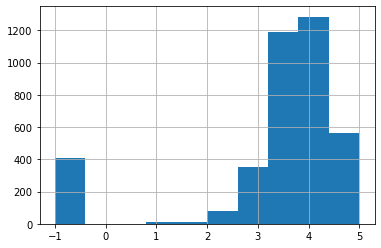

In [62]:
# notation
df.Rating.hist()

<AxesSubplot:>

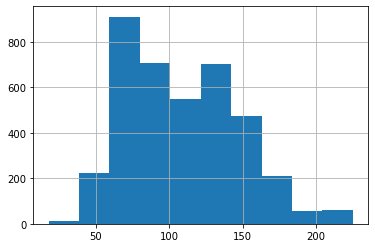

In [63]:
# salaire moyen
df.avg_salary.hist()

<AxesSubplot:>

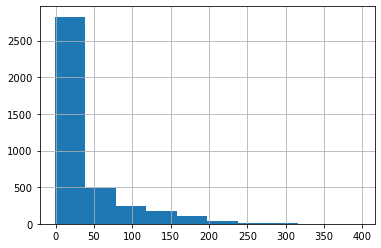

In [64]:
# age de l'entreprise
df.age.hist()

<AxesSubplot:>

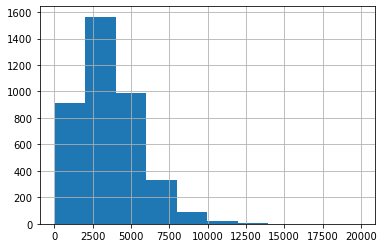

In [65]:
# job description
df.jobdesc_len.hist()

<AxesSubplot:>

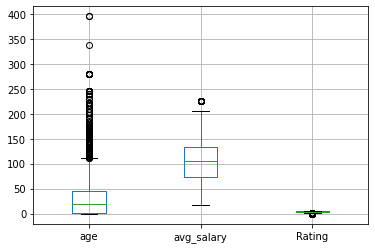

In [66]:
df.boxplot(column=['age', 'avg_salary', 'Rating'])

<AxesSubplot:>

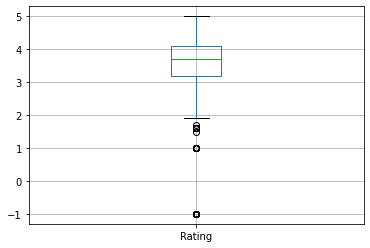

In [67]:
df.boxplot(column=['Rating'])

In [68]:
df[['age', 'avg_salary', 'Rating', 'jobdesc_len']].corr()

,age,avg_salary,Rating,jobdesc_len
age,1.000000,-0.026463,0.206365,0.388720
avg_salary,-0.026463,1.000000,0.057115,-0.004968
Rating,0.206365,0.057115,1.000000,0.078829
jobdesc_len,0.388720,-0.004968,0.078829,1.000000


<AxesSubplot:>

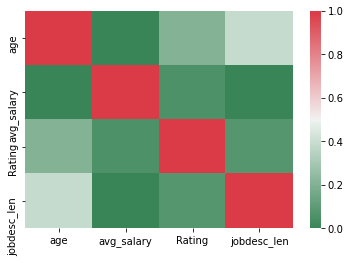

In [69]:
cmap = sns.diverging_palette(140, 10, as_cmap=True)
data = df[['age', 'avg_salary', 'Rating', 'jobdesc_len']].corr();
sns.heatmap(data, vmin=0, vmax=1, cmap=cmap)

In [70]:
df.columns

Index(['Unnamed: 0', 'index', 'Job Title', 'Salary Estimate',
       'Job Description', 'Rating', 'Company Name', 'Location', 'Headquarters',
       'Size', 'Founded', 'Type of ownership', 'Industry', 'Sector', 'Revenue',
       'Competitors', 'Easy Apply', 'hourly', 'min_salary', 'max_salary',
       'avg_salary', 'company_text', 'job_state', 'same_state', 'age',
       'python_yn', 'r_yn', 'spark', 'aws', 'excel', 'job_simplified',
       'job_seniority', 'jobdesc_len', 'nb_cpts'],
      dtype='object')

In [71]:
# nous allons garder uniquement les donnees interressantes pour notre model building
df_cat = df[['Location', 'Headquarters', 'Size', 'Industry', 'Sector', 'Revenue', 'company_text', 'job_state','same_state', 'python_yn',
       'spark', 'aws', 'excel', 'job_simplified', 'job_seniority']]

graph for Location: total = 20


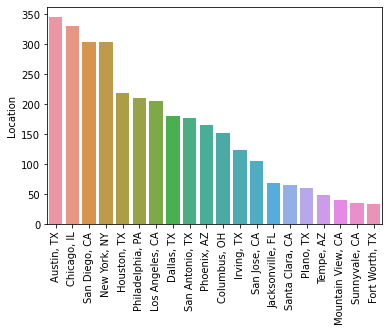

graph for Headquarters: total = 20


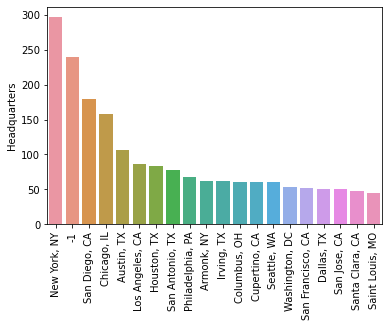

graph for company_text: total = 20


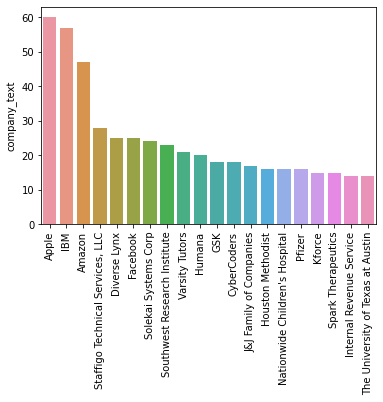

In [72]:
# pour afficher plusieur graph en renseignant les categories souhaitees
for i in df_cat[['Location', 'Headquarters', 'company_text']].columns:
    cat_num = df_cat[i].value_counts()[:20]
    print("graph for %s: total = %d" % (i, len(cat_num)))
    chart = sns.barplot(x=cat_num.index, y=cat_num)
    chart.set_xticklabels(chart.get_xticklabels(), rotation=90)
    plt.show()

In [73]:
df.columns

Index(['Unnamed: 0', 'index', 'Job Title', 'Salary Estimate',
       'Job Description', 'Rating', 'Company Name', 'Location', 'Headquarters',
       'Size', 'Founded', 'Type of ownership', 'Industry', 'Sector', 'Revenue',
       'Competitors', 'Easy Apply', 'hourly', 'min_salary', 'max_salary',
       'avg_salary', 'company_text', 'job_state', 'same_state', 'age',
       'python_yn', 'r_yn', 'spark', 'aws', 'excel', 'job_simplified',
       'job_seniority', 'jobdesc_len', 'nb_cpts'],
      dtype='object')

In [74]:
pd.pivot_table(df, index = 'job_simplified', values = 'avg_salary')

,avg_salary
job_simplified,
analyst,100.976136
data engineer,100.993261
data scientist,124.512195
director,98.472973
manager,109.963855
na,103.608199


In [75]:
pd.pivot_table(df, index = ['job_simplified','job_seniority'], values = 'avg_salary')

avg_salary
job_simplified job_seniority            
analyst        jr              80.500000
               na             101.767808
               senior          97.347973
data engineer  jr              92.700000
               na             100.440104
               senior         103.229814
data scientist jr             128.000000
               na             123.617378
               senior         126.296636
director       na              94.625000
               senior         123.100000
manager        na             109.662162
               senior         112.444444
na             jr             102.500000
               na             103.068966
               senior         105.594862

In [76]:
pd.pivot_table(df, index = ['job_state','job_simplified'], values = 'avg_salary').sort_values('job_state', ascending = False)

avg_salary
job_state       job_simplified            
 United Kingdom na               70.000000
                data scientist   68.500000
                analyst         190.000000
 TX             na               91.970506
                manager         109.769231
                director         85.200000
                data scientist  108.070423
                data engineer    94.960568
                analyst          90.335347
 PA             director         85.388889
                analyst          92.757576
                data scientist   93.067308
                data engineer    94.480392
                manager         115.000000
                na               96.242958
 OH             na               86.985075
                manager         107.666667
                director         62.500000
                data scientist  120.787500
                data engineer    78.858974
                analyst          93.851852
 NY             na              135.250000
                manager         134.625000
                director        135.250000
                data scientist  135.601485
                data engineer   130.970588
                analyst         138.386364
 NJ             na              122.000000
                data scientist  130.527778
                analyst          96.312500
                data engineer    95.000000
 IL             na               83.574713
                manager          68.722222
                director         92.500000
                data scientist   89.116162
                data engineer    93.685714
                analyst          76.936842
 FL             analyst          76.739130
                director         71.000000
                data engineer    78.208333
                data scientist   77.500000
                manager          74.250000
                na               77.960000
 DE             na              190.000000
                data scientist  135.400000
                data engineer    92.833333
 CA             na              123.633676
                manager         131.923077
                director        123.277778
                data scientist  148.158940
                data engineer   130.268657
                analyst         129.722488
 AZ             director        116.000000
                data scientist  115.478261
                data engineer    95.804124
                manager          83.833333
                na               93.230769
                analyst          92.980263

In [77]:
pd.options.display.max_rows
pd.set_option('display.max_rows', None)

# Model Building

In [78]:
# Récupération des colums à exploiter dans notre ,odel
df_model = df[['avg_salary','Rating','Size','Industry','Sector','Revenue','nb_cpts','hourly',
             'job_state','same_state','age','python_yn','spark','aws','excel','job_simplified','job_seniority','jobdesc_len']]

In [79]:
# récupération de données aléatoires
df_dump = pd.get_dummies(df_model);
df_dump

,avg_salary,Rating,nb_cpts,hourly,same_state,age,python_yn,spark,aws,excel,jobdesc_len,Size_-1,Size_1 to 50 employees,Size_10000+ employees,Size_1001 to 5000 employees,Size_201 to 500 employees,Size_5001 to 10000 employees,Size_501 to 1000 employees,Size_51 to 200 employees,Size_Unknown,Industry_-1,Industry_Accounting,Industry_Advertising & Marketing,Industry_Aerospace & Defense,Industry_Architectural & Engineering Services,Industry_Audiovisual,Industry_Auto Repair & Maintenance,Industry_Automotive Parts & Accessories Stores,Industry_Banks & Credit Unions,Industry_Beauty & Personal Accessories Stores,Industry_Biotech & Pharmaceuticals,Industry_Brokerage Services,Industry_Building & Personnel Services,"Industry_Cable, Internet & Telephone Providers",Industry_Casual Restaurants,Industry_Chemical Manufacturing,Industry_Colleges & Universities,Industry_Commercial Equipment Rental,Industry_Computer Hardware & Software,Industry_Construction,Industry_Consulting,Industry_Consumer Electronics & Appliances Stores,Industry_Consumer Product Rental,Industry_Consumer Products Manufacturing,Industry_Convenience Stores & Truck Stops,Industry_Cruise Ships,"Industry_Department, Clothing, & Shoe Stores",Industry_Education Training Services,Industry_Electrical & Electronic Manufacturing,Industry_Energy,Industry_Enterprise Software & Network Solutions,Industry_Express Delivery Services,Industry_Farm Support Services,Industry_Fast-Food & Quick-Service Restaurants,Industry_Federal Agencies,Industry_Financial Analytics & Research,Industry_Financial Transaction Processing,Industry_Food & Beverage Manufacturing,Industry_Food & Beverage Stores,Industry_Food Production,Industry_Gambling,Industry_Gas Stations,Industry_Grantmaking Foundations,Industry_Grocery Stores & Supermarkets,Industry_Health Care Products Manufacturing,Industry_Health Care Services & Hospitals,Industry_Health Fundraising Organizations,"Industry_Health, Beauty, & Fitness",Industry_Home Furniture & Housewares Stores,Industry_IT Services,Industry_Industrial Manufacturing,Industry_Insurance Agencies & Brokerages,Industry_Insurance Carriers,Industry_Internet,Industry_Investment Banking & Asset Management,Industry_K-12 Education,Industry_Legal,Industry_Lending,Industry_Logistics & Supply Chain,Industry_Membership Organizations,Industry_Metals Brokers,Industry_Motion Picture Production & Distribution,Industry_Municipal Governments,"Industry_Museums, Zoos & Amusement Parks",Industry_News Outlet,Industry_Oil & Gas Exploration & Production,Industry_Oil & Gas Services,Industry_Other Retail Stores,Industry_Pet & Pet Supplies Stores,Industry_Publishing,Industry_Radio,Industry_Real Estate,Industry_Religious Organizations,Industry_Research & Development,Industry_Security Services,Industry_Self-Storage Services,Industry_Shipping,Industry_Social Assistance,Industry_Sporting Goods Stores,Industry_Sports & Recreation,Industry_Staffing & Outsourcing,Industry_State & Regional Agencies,Industry_Stock Exchanges,Industry_TV Broadcast & Cable Networks,Industry_Telecommunications Manufacturing,Industry_Telecommunications Services,Industry_Transportation Equipment Manufacturing,Industry_Transportation Management,Industry_Travel Agencies,Industry_Truck Rental & Leasing,Industry_Trucking,Industry_Utilities,Industry_Vehicle Dealers,Industry_Venture Capital & Private Equity,Industry_Video Games,Industry_Wholesale,Sector_-1,Sector_Accounting & Legal,Sector_Aerospace & Defense,Sector_Agriculture & Forestry,"Sector_Arts, Entertainment & Recreation",Sector_Biotech & Pharmaceuticals,Sector_Business Services,"Sector_Construction, Repair & Maintenance",Sector_Consumer Services,Sector_Education,Sector_Finance,Sector_Government,Sector_Health Care,Sector_Information Technology,Sector_Insurance,Sector_Manufacturing,Sector_Media,Sector_Mining & Metals,Sector_Non-Profit,"Sector_Oil, Gas, Energy & Utilities",Sector_Real Estate,"Sector_Restaurants, Bars & Food Services",Sector_Retail,Sector_Telecommunications,Sector_Transportatio

In [82]:
# echantillons d'entrainement et de test
from sklearn.model_selection import train_test_split

X = df_dump.drop('avg_salary', axis =1)
y = df_dump.avg_salary.values

In [84]:
# Echantillon scinde en 2 partie : 70% sur le train set et 30% sur notre test set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=59)

In [88]:
# importation des librairies pour calculer notre regression lineaire
from sklearn.linear_model import LinearRegression, Lasso
from sklearn.model_selection import cross_val_score

In [94]:
# affection variable + mise en application via la fonction fit 
lr = LinearRegression()
lr.fit(X_train, y_train)

LinearRegression()

In [95]:
# calcul de la marge d'erreur
np.mean(cross_val_score(lm,X_train,y_train, scoring = 'neg_mean_absolute_error', cv= 3))

-26.515913982167188

In [96]:
# lasso regression 
lm_l = Lasso(alpha=.13)
lm_l.fit(X_train,y_train)
np.mean(cross_val_score(lm_l,X_train,y_train, scoring = 'neg_mean_absolute_error', cv= 3))

-26.155557451393353

In [97]:
alpha = []
error = []

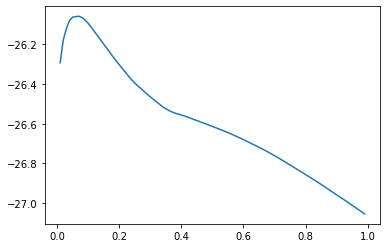

In [98]:
for i in range(1,100):
    alpha.append(i/100)
    lml = Lasso(alpha=(i/100))
    error.append(np.mean(cross_val_score(lml,X_train,y_train, scoring = 'neg_mean_absolute_error', cv= 3)))
    
plt.plot(alpha,error)